# Segmentation Masks and Neural Style Transfer

Localized application of neural style transfers and other special effects


### Project Overview
1. Create a segmentation mask using Mask R-CNN
    - Identify objects and background to apply the misc. effects
2. Grey-scale image with colorized segmented object
3. Neural style transfer on segmented object or background

In [54]:
import os
import sys
import random
import math
import numpy as np
import skimage.io
import matplotlib
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import warnings; warnings.simplefilter('ignore')
import pandas as pd

%matplotlib inline

from IPython.display import display_html
def restartkernel() :
    display_html("<script>Jupyter.notebook.kernel.restart()</script>",raw=True)

## Mask R-CNN

Leverages Matterport's Mask R-CNN library and Microsoft's COCO model

In [55]:
# Root directory of the project
ROOT_DIR = os.path.abspath("../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize

# Import COCO config
sys.path.append(os.path.join(ROOT_DIR, "coco/"))  # To find local version
import coco

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "data/logs")

MASK_DIR = os.path.join(ROOT_DIR, "data/masks")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "data/mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

# Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "images")

In [56]:
class InferenceConfig(coco.CocoConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    
config = InferenceConfig()

In [57]:
model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=config)

# Load weights trained on MS-COCO
model.load_weights(COCO_MODEL_PATH, by_name=True)

In [58]:
# Class names included by Matterport (subset of MS COCO)

class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

original_image = skimage.io.imread(os.path.join(IMAGE_DIR, 'brooklyn_bridge.jpg'))

results = model.detect([original_image], verbose=1)

Processing 1 images
image                    shape: (953, 960, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


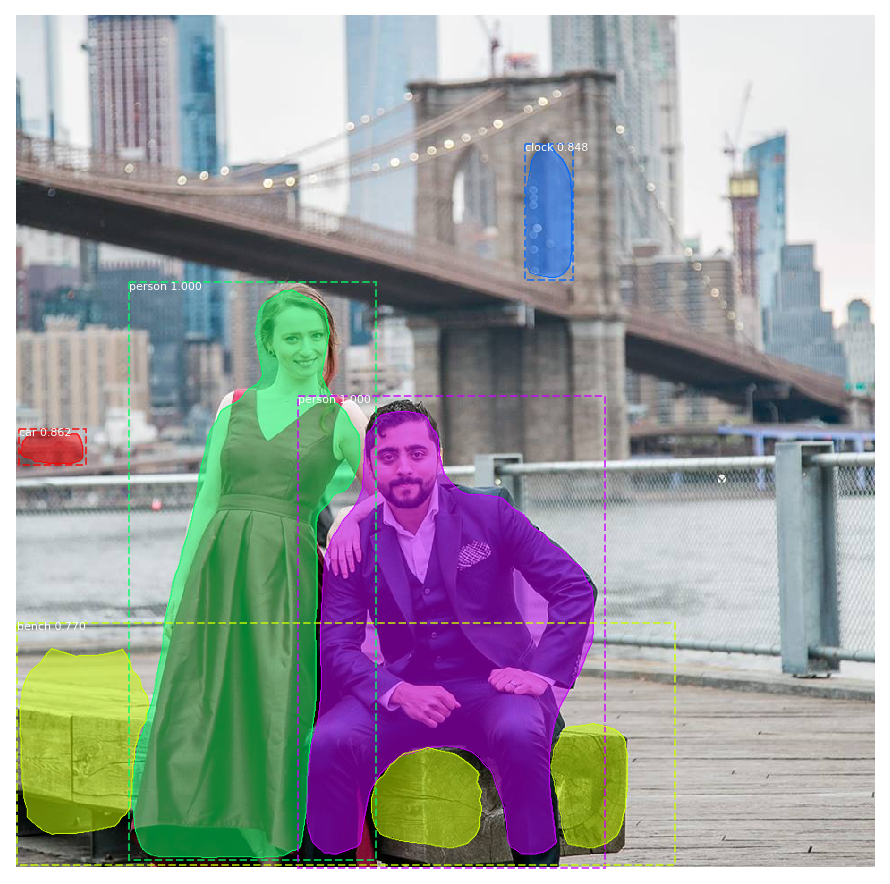

In [59]:
r = results[0]
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            class_names, r['scores'])



### Select all the person masks

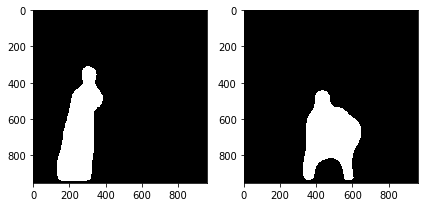

In [66]:


masks = []

for segmented_object in range(len(r['scores'])):
    if r['scores'][segmented_object] > 0.90 and \
        class_names[r['class_ids'][segmented_object]] == 'person':
        mask = r['masks'][:, :, segmented_object]
        np.save(os.path.join(MASK_DIR, 'mask_{}'.format(segmented_object)), mask)
        masks.append(mask)

for i in range(len(masks)):
    plt.subplot(1,2,i+1)
    skimage.io.imshow(masks[i])

plt.show()

# Greyscale background

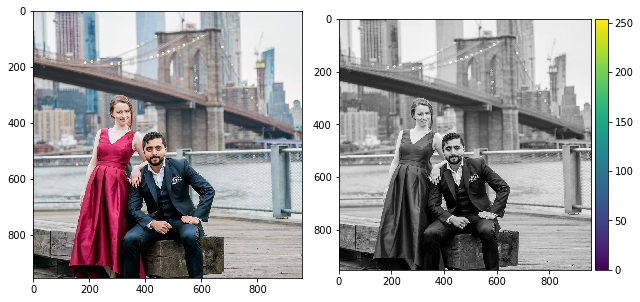

In [67]:
# Convert RGB image to 3 channel grayscale 

def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])

final_image = np.stack((rgb2gray(original_image).astype(int),)*3, axis=-1)

fig = plt.figure(figsize=(9,9))
plt.subplot(1, 2, 1)
skimage.io.imshow(original_image)

plt.subplot(1, 2, 2)
skimage.io.imshow(final_image)

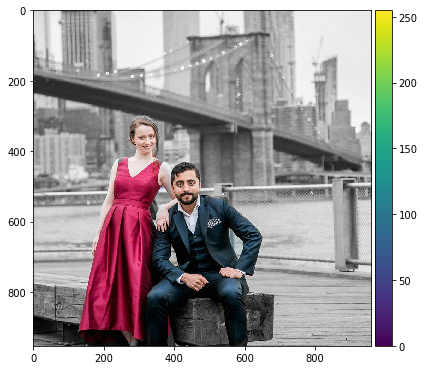

In [68]:
for i in range(len(masks)):
    mask_3channel = np.stack((masks[i],)*3, axis=-1)
    final_image = np.where(mask_3channel, original_image, final_image)

fig = plt.figure(figsize=(6,6))
skimage.io.imshow(final_image)

In [72]:
# Persisting masks for further use
mask_names = next(os.walk(MASK_DIR))[2]
mask_names

['mask_0.npy', 'mask_1.npy']

# Neural Style Transfer

For the Neural style transfer, I applied Tensorflow's basic example, and I will extend it with the segmented mask aquired above.   

In [ ]:
restartkernel()

In [1]:
import tensorflow as tf
tf.enable_eager_execution()
# print("Eager execution: {}".format(tf.executing_eagerly()))


import tensorflow.contrib.eager as tfe

from tensorflow.python.keras.preprocessing import image as kp_image
from tensorflow.python.keras import models 
from tensorflow.python.keras import losses
from tensorflow.python.keras import layers
from tensorflow.python.keras import backend as K


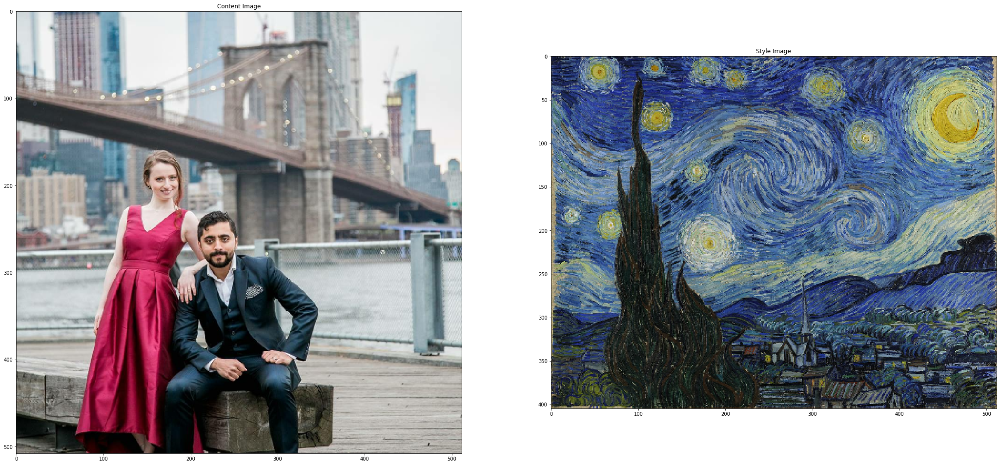

In [39]:
from __future__ import absolute_import, division, print_function, unicode_literals
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (36,36)
mpl.rcParams['axes.grid'] = False

import numpy as np
import time
import functools
import os
import skimage.io
import matplotlib
import matplotlib.pyplot as plt
from skimage.transform import resize

ROOT_DIR = os.path.abspath("../")

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "data/logs")

MASK_DIR = os.path.join(ROOT_DIR, "data/masks")


def load_img(path_to_img):
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    max_dim = 512

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]
    return img

def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

        plt.imshow(image)
    if title:
        plt.title(title)
        
# content_image = load_img(content_path)
content_image = load_img(os.path.join(ROOT_DIR, 'images/brooklyn_bridge.jpg'))
style_image = load_img(os.path.join(ROOT_DIR, 'images/starry_night.jpg'))

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [6]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
r = vgg(x)

labels_path = tf.keras.utils.get_file(
    'ImageNetLabels.txt', 'https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
imagenet_labels = np.array(open(labels_path).read().splitlines())

print(imagenet_labels[np.argsort(r)[0,::-1][:5]+1])

['abaya' 'cloak' 'stole' 'pier' 'jean']


In [7]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

In [11]:
content_layers = ['block5_conv2'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)


def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. We load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)


class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}
    
    
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

style_results = results['style']

In [12]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

image = tf.Variable(content_image)
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

# opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
opt = tf.train.AdamOptimizer(learning_rate=0.02, beta1=0.99, epsilon=1e-1)

style_weight=1e-2
content_weight=1e4

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss


def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)

        grad = tape.gradient(loss, image)
        opt.apply_gradients([(grad, image)])
        image.assign(clip_0_1(image))

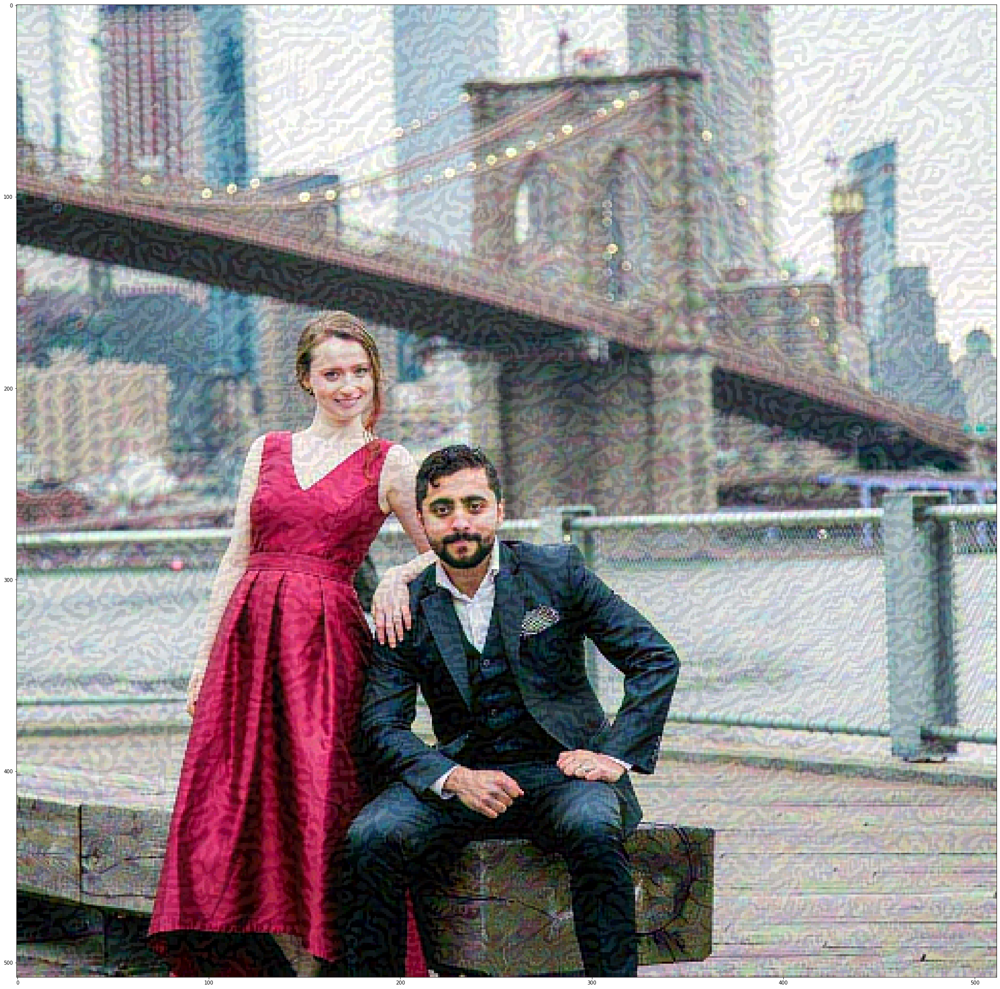

In [13]:
train_step(image)
train_step(image)
train_step(image)
plt.imshow(image.read_value()[0])

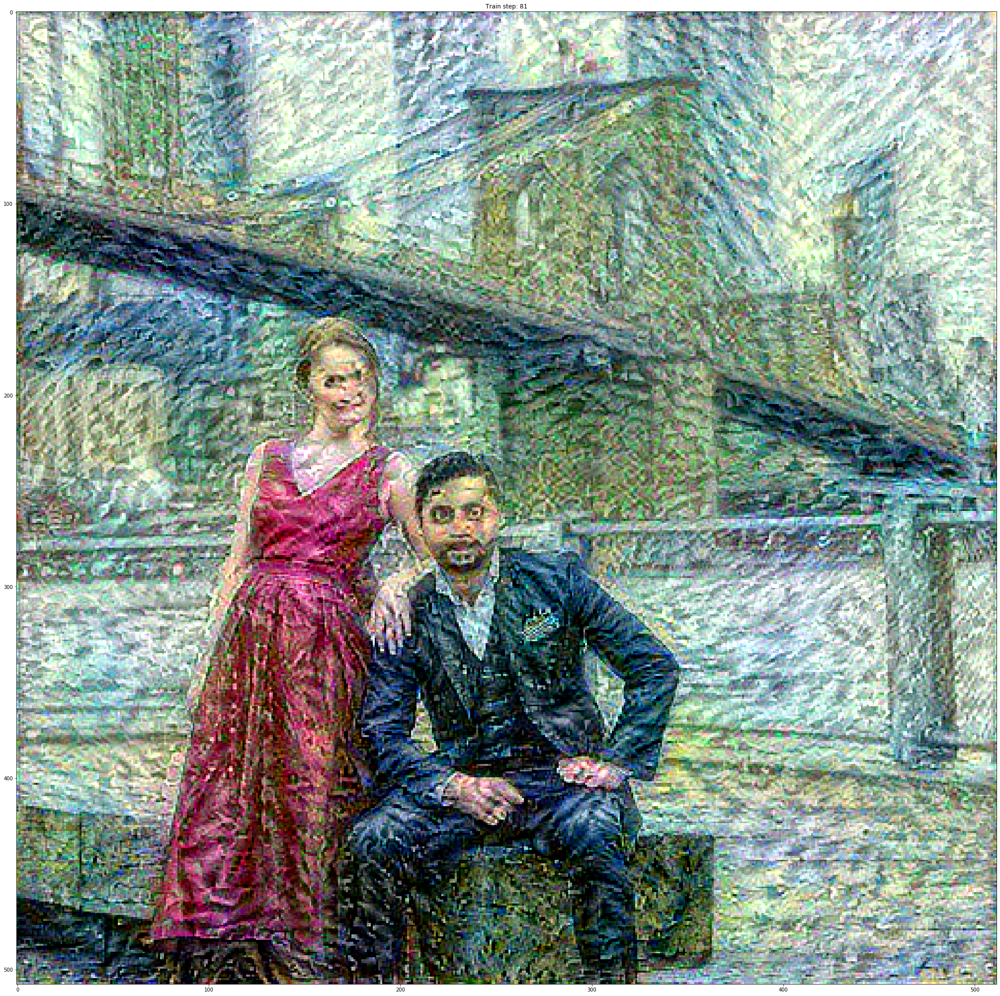

Total time: 1363.7


In [14]:
import time
start = time.time()

epochs = 9
steps_per_epoch = 9

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
        print(".", end='')
    display.clear_output(wait=True)
    imshow(image.read_value())
    plt.title("Train step: {}".format(step))
    plt.show()

end = time.time()
print("Total time: {:.1f}".format(end-start))

In [16]:
if len(image.shape) > 3:
    stylized_content = np.array(tf.squeeze(image, axis=0))
    
if len(content_image.shape) >3:    
    original_content = np.array(tf.squeeze(content_image, axis=0))

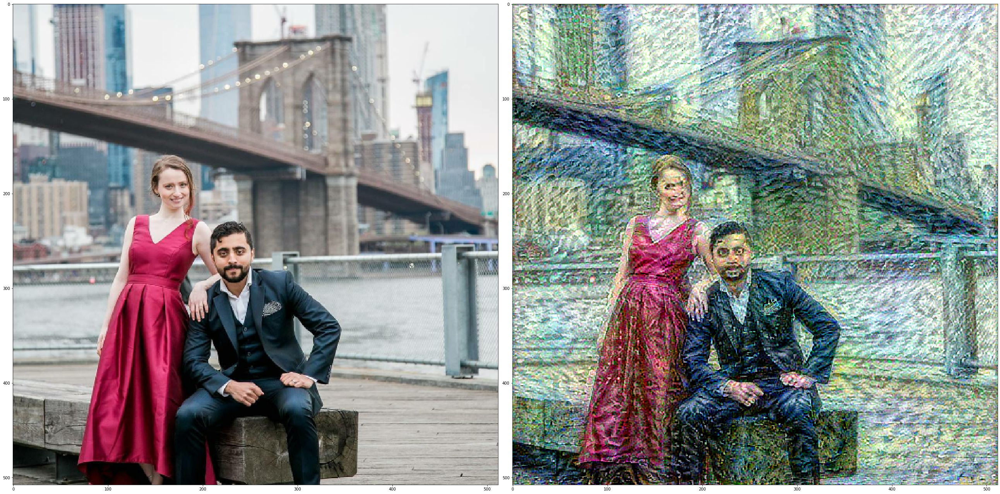

In [23]:
plt.subplot(1,2,1)
skimage.io.imshow(original_content)

plt.subplot(1,2,2)
skimage.io.imshow(stylized_content)

In [85]:
masked_stylized = np.array(stylized_content)

masks = next(os.walk(MASK_DIR))[2]

for i in range(len(masks)):
    print(masks[i])
    mask_arr = np.load(MASK_DIR + '/' + masks[i])
    mask_resized = resize(mask_arr, stylized_content.shape[:2], anti_aliasing=True).astype(bool)
    masked_stylized = np.where(np.stack((mask_resized,), axis=-1), original_content, masked_stylized)
    

mask_0.npy
mask_1.npy


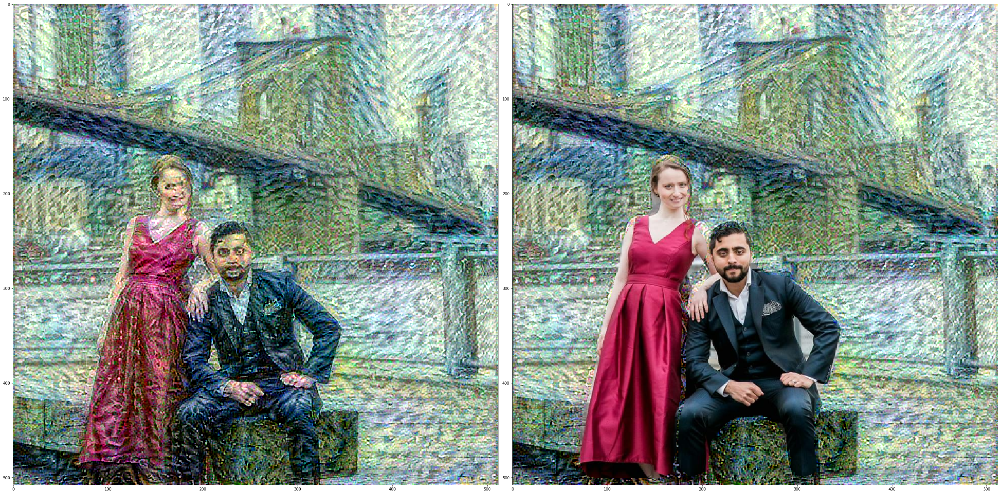

In [86]:
plt.subplot(1,2,1)
skimage.io.imshow(stylized_content)

plt.subplot(1,2,2)
skimage.io.imshow(masked_stylized)

mask_0.npy
mask_1.npy


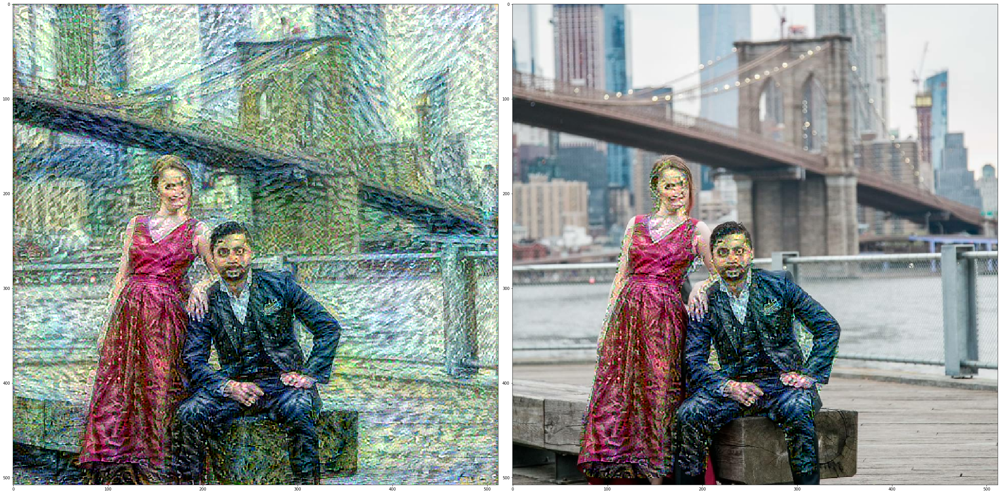

In [88]:
masked_stylized_2 = np.array(original_content)

masks = next(os.walk(MASK_DIR))[2]

for i in range(len(masks)):
    print(masks[i])
    mask_arr = np.load(MASK_DIR + '/' + masks[i])
    mask_resized = resize(mask_arr, stylized_content.shape[:2], anti_aliasing=True).astype(bool)
    masked_stylized_2 = np.where(np.stack((mask_resized,), axis=-1), stylized_content, masked_stylized_2)

plt.subplot(1,2,1)
skimage.io.imshow(stylized_content)

plt.subplot(1,2,2)
skimage.io.imshow(masked_stylized_2)

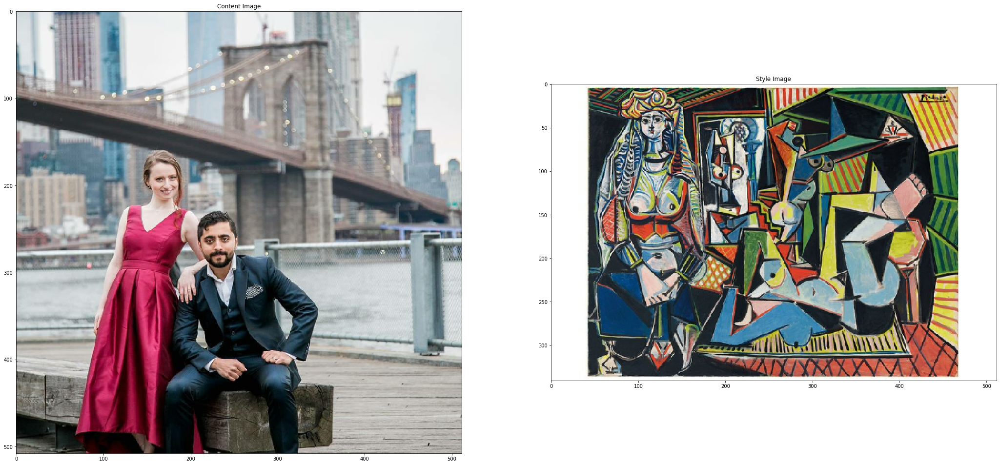

In [89]:
style_image = load_img(os.path.join(ROOT_DIR, 'images/christies-picasso-les-femmes-dalger.jpg'))

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [98]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
r = vgg(x)

labels_path = tf.keras.utils.get_file(
    'ImageNetLabels.txt', 'https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
imagenet_labels = np.array(open(labels_path).read().splitlines())

print(imagenet_labels[np.argsort(r)[0,::-1][:5]+1])

['abaya' 'cloak' 'stole' 'pier' 'jean']


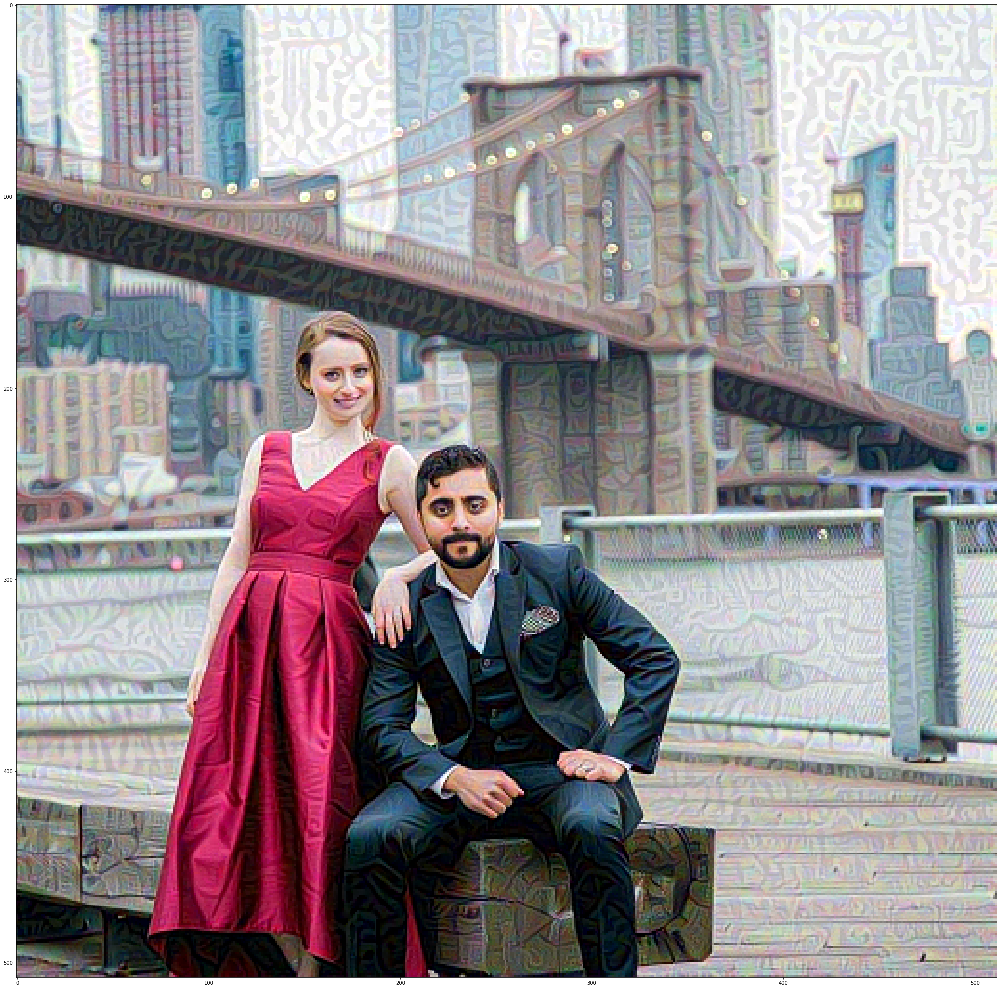

In [100]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

content_layers = ['block5_conv2'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)


def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. We load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)


class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}
    
    
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

style_results = results['style']


style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

image = tf.Variable(content_image)
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

# opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
opt = tf.train.AdamOptimizer(learning_rate=0.02, beta1=0.99, epsilon=1e-1)

style_weight=1e-2
content_weight=1e4

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss


def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)

        grad = tape.gradient(loss, image)
        opt.apply_gradients([(grad, image)])
        image.assign(clip_0_1(image))
        
train_step(image)
train_step(image)
train_step(image)
plt.imshow(image.read_value()[0])       

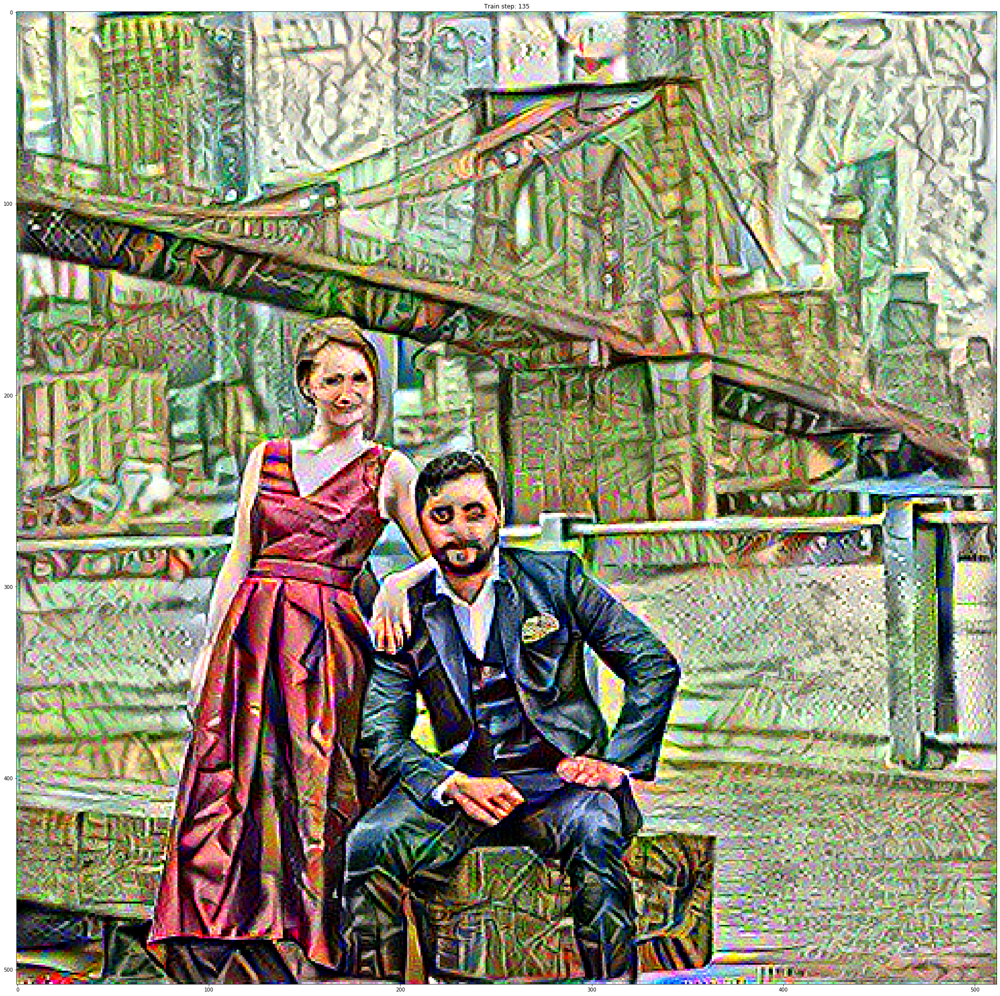

Total time: 2582.3


In [113]:
import time
start = time.time()

epochs = 15
steps_per_epoch = 9

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
        print(".", end='')
    display.clear_output(wait=True)
    imshow(image.read_value())
    plt.title("Train step: {}".format(step))
    plt.show()

end = time.time()
print("Total time: {:.1f}".format(end-start))

In [115]:
if len(image.shape) > 3:
    stylized_content_picasso = np.array(tf.squeeze(image, axis=0))
    
if len(content_image.shape) >3:    
    original_content = np.array(tf.squeeze(content_image, axis=0))

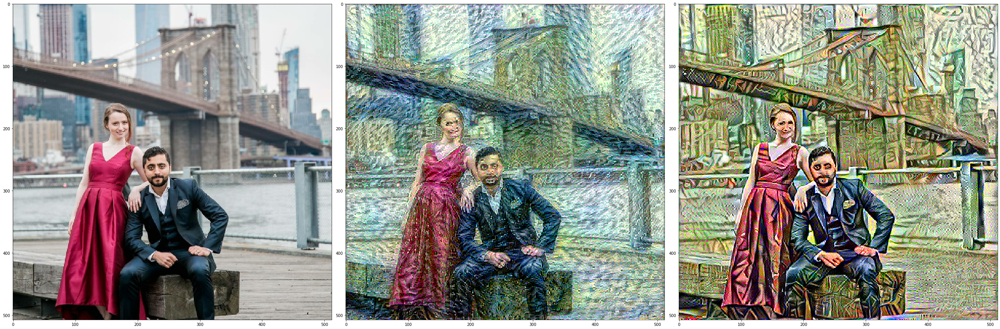

In [116]:
plt.subplot(1,3,1)
skimage.io.imshow(original_content)

plt.subplot(1,3,2)
skimage.io.imshow(stylized_content)

plt.subplot(1,3,3)
skimage.io.imshow(stylized_content_picasso)

mask_0.npy
mask_1.npy


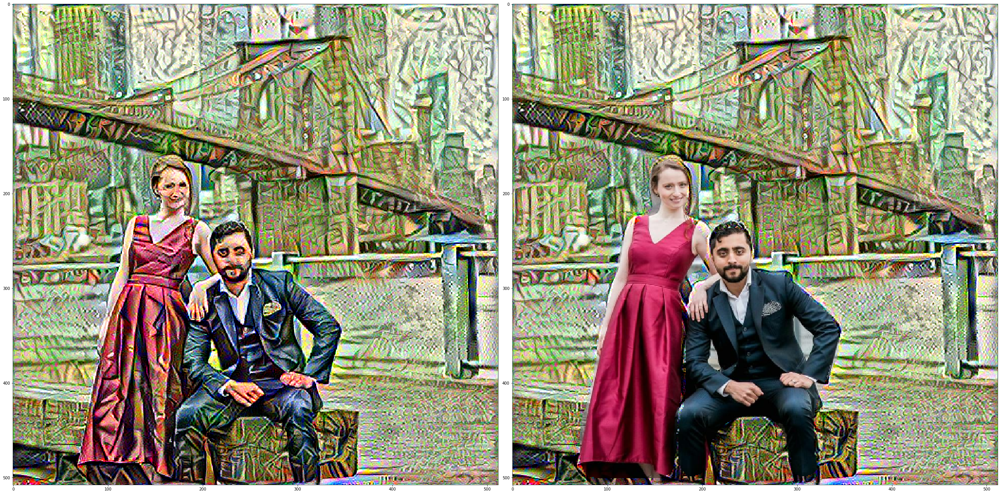

In [117]:
masked_stylized_picasso = np.array(stylized_content_picasso)

for i in range(len(masks)):
    print(masks[i])
    mask_arr = np.load(MASK_DIR + '/' + masks[i])
    mask_resized = resize(mask_arr, stylized_content_picasso.shape[:2], anti_aliasing=True).astype(bool)
    masked_stylized_picasso = np.where(np.stack((mask_resized,), axis=-1), original_content, masked_stylized_picasso)

plt.subplot(1,2,1)
skimage.io.imshow(stylized_content_picasso)

plt.subplot(1,2,2)
skimage.io.imshow(masked_stylized_picasso)

mask_0.npy
mask_1.npy


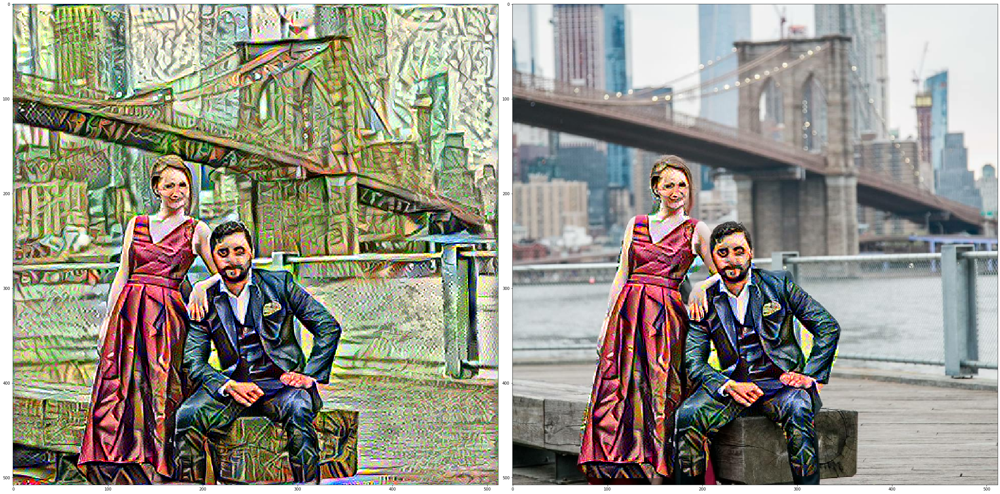

In [118]:
masked_stylized_picasso_2 = np.array(original_content)

for i in range(len(masks)):
    print(masks[i])
    mask_arr = np.load(MASK_DIR + '/' + masks[i])
    mask_resized = resize(mask_arr, stylized_content_picasso.shape[:2], anti_aliasing=True).astype(bool)
    masked_stylized_picasso_2 = np.where(np.stack((mask_resized,), axis=-1), stylized_content_picasso, masked_stylized_picasso_2)

plt.subplot(1,2,1)
skimage.io.imshow(stylized_content_picasso)

plt.subplot(1,2,2)
skimage.io.imshow(masked_stylized_picasso_2)